<a href="https://colab.research.google.com/github/Naziaftrn/PengolahanCitraDigital/blob/main/PendeteksianSuara.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Pendeteksian Suara- Tugas Pengolahan Citra Digital

Kelompok
*   Nazia Fitra Aini (C22555201002)
*   Siska Tiara (C2255201008)
*   Indria Wulandari (C2255201040)





In [1]:
!pip install pydub
!apt-get install ffmpeg
!pip install noisereduce

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


**1). Mengakses Data Suara**

In [2]:
# Mengimpor library yang dibutuhkan
from google.colab import drive
import os

# Mount Google Drive
drive.mount('/content/drive', force_remount=True)

# Path ke folder audio
audio_dir = '/content/drive/MyDrive/deteksisuara_PCD/allfiles'

# Memeriksa apakah folder ada
if os.path.exists(audio_dir):
    # Menampilkan isi folder untuk memastikan file ada
    print("Isi folder audio:", os.listdir(audio_dir))
else:
    print(f"Folder tidak ditemukan: {audio_dir}")
    print("Pastikan path folder sudah benar dan folder tersebut ada di Google Drive Anda.")

Mounted at /content/drive
Isi folder audio: ['anak1.mp3', 'anak2.mp3', 'anak3.mp3', 'anak4.mp3', 'anak5.mp3', 'pria1.mp3', 'pria5.mp3', 'pria4.mp3', 'pria2.mp3', 'pria3.mp3', 'wanita3.mp3', 'wanita4.mp3', 'wanita5.mp3', 'wanita2.mp3', 'wanita1.mp3']


mengubah ekstensi audio .mp3 ke .wav

In [3]:
# Mengimpor library yang dibutuhkan
from pydub import AudioSegment
import os

# Fungsi untuk mengonversi MP3 ke WAV
def convert_mp3_to_wav(mp3_path, wav_path):
    audio = AudioSegment.from_mp3(mp3_path)
    audio.export(wav_path, format="wav")
    print(f"File {mp3_path} telah dikonversi ke {wav_path}")

# Path ke folder audio
audio_dir = '/content/drive/MyDrive/deteksisuara_PCD/allfiles'

# Loop untuk mengonversi semua file MP3 di dalam folder ke WAV
for filename in os.listdir(audio_dir):
    if filename.endswith(".mp3"):  # Filter file MP3
        mp3_path = os.path.join(audio_dir, filename)
        wav_path = mp3_path.replace(".mp3", ".wav")  # Ganti ekstensi menjadi .wav
        convert_mp3_to_wav(mp3_path, wav_path)


File /content/drive/MyDrive/deteksisuara_PCD/allfiles/anak1.mp3 telah dikonversi ke /content/drive/MyDrive/deteksisuara_PCD/allfiles/anak1.wav
File /content/drive/MyDrive/deteksisuara_PCD/allfiles/anak2.mp3 telah dikonversi ke /content/drive/MyDrive/deteksisuara_PCD/allfiles/anak2.wav
File /content/drive/MyDrive/deteksisuara_PCD/allfiles/anak3.mp3 telah dikonversi ke /content/drive/MyDrive/deteksisuara_PCD/allfiles/anak3.wav
File /content/drive/MyDrive/deteksisuara_PCD/allfiles/anak4.mp3 telah dikonversi ke /content/drive/MyDrive/deteksisuara_PCD/allfiles/anak4.wav
File /content/drive/MyDrive/deteksisuara_PCD/allfiles/anak5.mp3 telah dikonversi ke /content/drive/MyDrive/deteksisuara_PCD/allfiles/anak5.wav
File /content/drive/MyDrive/deteksisuara_PCD/allfiles/pria1.mp3 telah dikonversi ke /content/drive/MyDrive/deteksisuara_PCD/allfiles/pria1.wav
File /content/drive/MyDrive/deteksisuara_PCD/allfiles/pria5.mp3 telah dikonversi ke /content/drive/MyDrive/deteksisuara_PCD/allfiles/pria5.wav

**2). Normalisasi Audio, Pmotongan durasi, ekstraksi fitur mfcc**

In [4]:
from pydub import AudioSegment
import os

# Fungsi untuk normalisasi audio
def normalize_audio(audio_path):
    audio = AudioSegment.from_file(audio_path)
    normalized_audio = audio.normalize()
    return normalized_audio

# Path ke folder audio yang sudah dikonversi menjadi WAV
audio_dir = '/content/drive/MyDrive/deteksisuara_PCD/allfiles'
# Path ke folder tujuan untuk menyimpan audio yang telah dinormalisasi
output_dir = '/content/drive/MyDrive/deteksisuara_PCD/hasilnorm'

# Pastikan folder tujuan ada
os.makedirs(output_dir, exist_ok=True)

# Menormalisasi semua file WAV di dalam folder
for filename in os.listdir(audio_dir):
    if filename.endswith(".wav"):  # Filter file WAV
        file_path = os.path.join(audio_dir, filename)

        # Normalisasi audio dan simpan sebagai file WAV baru
        normalized_audio = normalize_audio(file_path)

        # Tentukan path output untuk file yang dinormalisasi
        output_path = os.path.join(output_dir, filename.replace(".wav", "_normalized.wav"))

        # Ekspor file yang telah dinormalisasi
        normalized_audio.export(output_path, format="wav")
        print(f"Audio {filename} dinormalisasi dan disimpan sebagai {output_path}")


Audio anak1.wav dinormalisasi dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/anak1_normalized.wav
Audio anak2.wav dinormalisasi dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/anak2_normalized.wav
Audio anak3.wav dinormalisasi dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/anak3_normalized.wav
Audio anak4.wav dinormalisasi dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/anak4_normalized.wav
Audio anak5.wav dinormalisasi dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/anak5_normalized.wav
Audio pria1.wav dinormalisasi dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/pria1_normalized.wav
Audio pria5.wav dinormalisasi dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/pria5_normalized.wav
Audio pria4.wav dinormalisasi dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/pria4_normalized.wav
Audio pria2.wav dinormal

pemotongan durasi audio setelah tahap normalisasi

In [5]:
from pydub import AudioSegment
import os

# Fungsi untuk memotong audio setelah normalisasi
def cut_audio(audio_path, duration_ms):
    audio = AudioSegment.from_file(audio_path)

    # Memotong audio menjadi durasi yang diinginkan (dalam milidetik)
    cut_audio = audio[:duration_ms]  # Ambil hanya 15 detik pertama
    return cut_audio

# Path ke folder audio yang sudah dinormalisasi
normalized_audio_dir = '/content/drive/MyDrive/deteksisuara_PCD/hasilnorm'
# Path ke folder tujuan untuk menyimpan audio yang telah dipotong
output_cut_dir = '/content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut'

# Pastikan folder tujuan ada
os.makedirs(output_cut_dir, exist_ok=True)

# Durasi pemotongan dalam milidetik (15 detik = 15000 ms)
duration_ms = 15000

# Menemukan dan memotong semua file WAV yang ada dalam folder hasil normalisasi
for filename in os.listdir(normalized_audio_dir):
    if filename.endswith(".wav"):  # Filter file WAV
        file_path = os.path.join(normalized_audio_dir, filename)

        # Potong audio menjadi 15 detik pertama
        cut_audio_segment = cut_audio(file_path, duration_ms)

        # Tentukan path output untuk file yang dipotong
        output_cut_path = os.path.join(output_cut_dir, filename.replace(".wav", "_cut.wav"))

        # Ekspor file yang telah dipotong
        cut_audio_segment.export(output_cut_path, format="wav")
        print(f"Audio {filename} dipotong menjadi 15 detik dan disimpan sebagai {output_cut_path}")


Audio anak1_normalized.wav dipotong menjadi 15 detik dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut/anak1_normalized_cut.wav
Audio anak2_normalized.wav dipotong menjadi 15 detik dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut/anak2_normalized_cut.wav
Audio anak3_normalized.wav dipotong menjadi 15 detik dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut/anak3_normalized_cut.wav
Audio anak4_normalized.wav dipotong menjadi 15 detik dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut/anak4_normalized_cut.wav
Audio anak5_normalized.wav dipotong menjadi 15 detik dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut/anak5_normalized_cut.wav
Audio pria1_normalized.wav dipotong menjadi 15 detik dan disimpan sebagai /content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut/pria1_normalized_cut.wav
Audio pria5_normalized.wav dipotong menjadi 15 detik

menampilkan hasil suara setelah di normalisasi dan setelah pemotongan durasi

In [6]:
import os
from IPython.display import Audio, display

# Path ke folder hasil pemotongan audio
cut_audio_dir = '/content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut'

# Menampilkan dan memutar semua file audio di dalam folder
for filename in os.listdir(cut_audio_dir):
    if filename.endswith(".wav"):  # Filter file WAV
        file_path = os.path.join(cut_audio_dir, filename)

        # Menampilkan nama file audio
        print(f"Menampilkan dan memutar audio: {filename}")

        # Memutar file audio menggunakan IPython.display.Audio
        display(Audio(file_path))  # Akan menampilkan player untuk memutar audio


Menampilkan dan memutar audio: anak1_normalized_cut.wav


Menampilkan dan memutar audio: anak2_normalized_cut.wav


Menampilkan dan memutar audio: anak3_normalized_cut.wav


Menampilkan dan memutar audio: anak4_normalized_cut.wav


Menampilkan dan memutar audio: anak5_normalized_cut.wav


Menampilkan dan memutar audio: pria1_normalized_cut.wav


Menampilkan dan memutar audio: pria5_normalized_cut.wav


Menampilkan dan memutar audio: pria4_normalized_cut.wav


Menampilkan dan memutar audio: pria2_normalized_cut.wav


Menampilkan dan memutar audio: pria3_normalized_cut.wav


Menampilkan dan memutar audio: wanita3_normalized_cut.wav


Menampilkan dan memutar audio: wanita4_normalized_cut.wav


Menampilkan dan memutar audio: wanita5_normalized_cut.wav


Menampilkan dan memutar audio: wanita2_normalized_cut.wav


Menampilkan dan memutar audio: wanita1_normalized_cut.wav


ekstraksi fitur mfcc

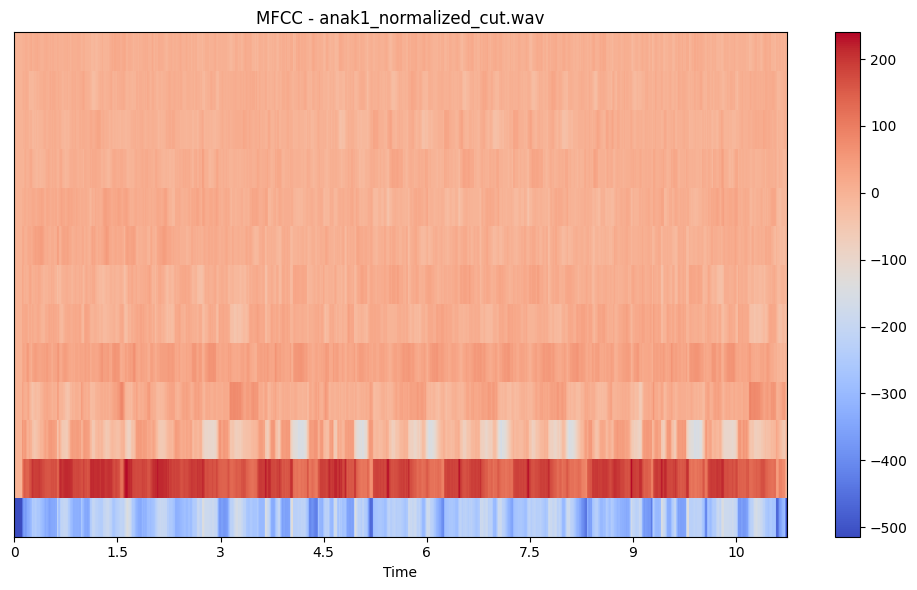

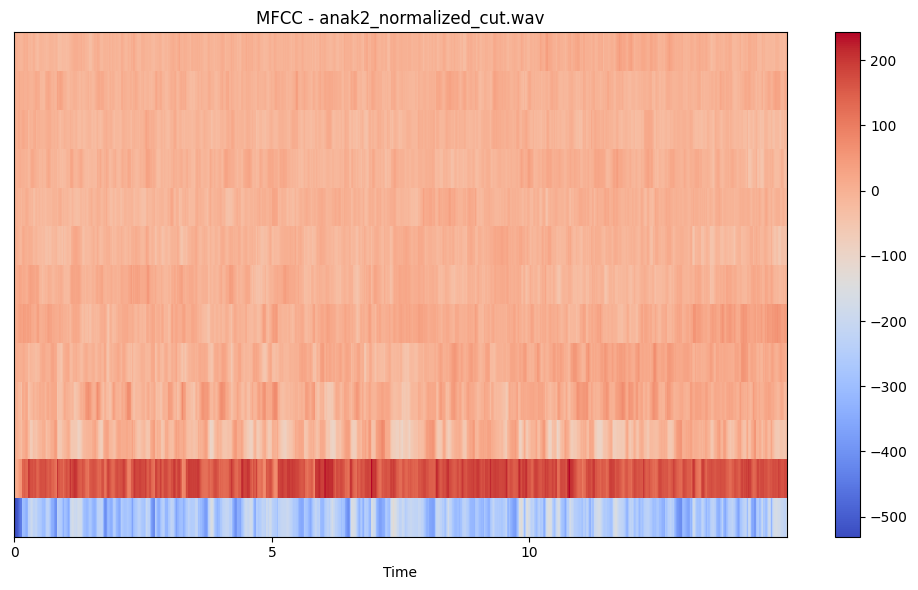

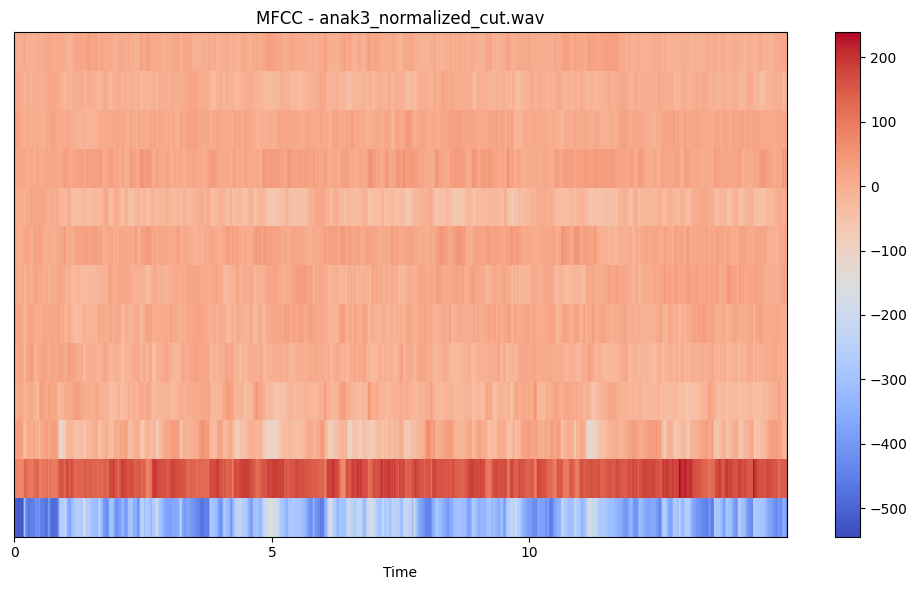

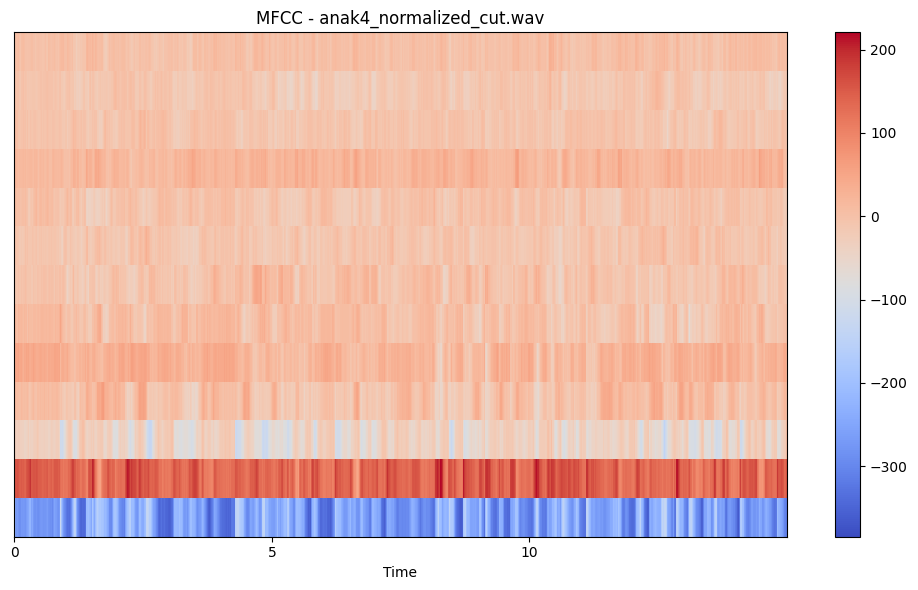

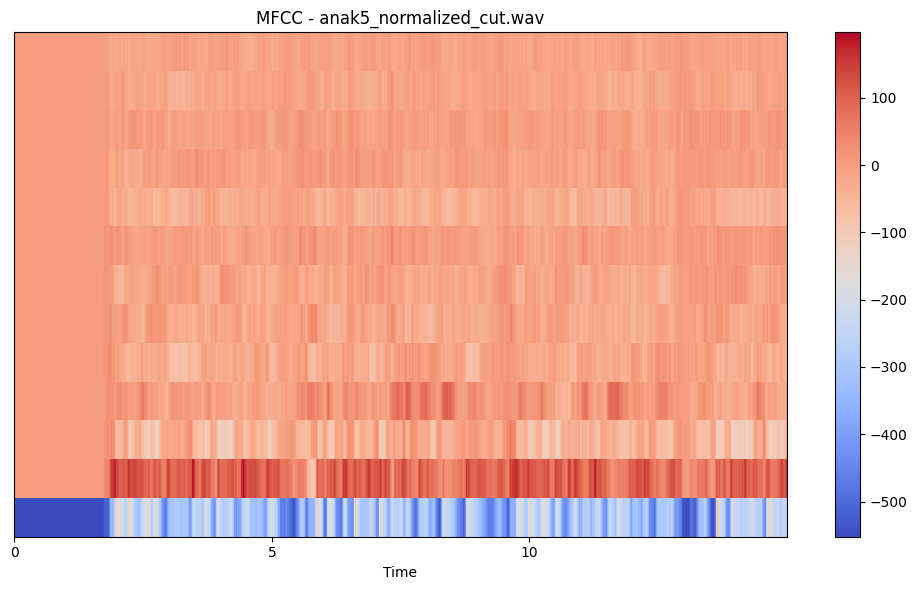

...

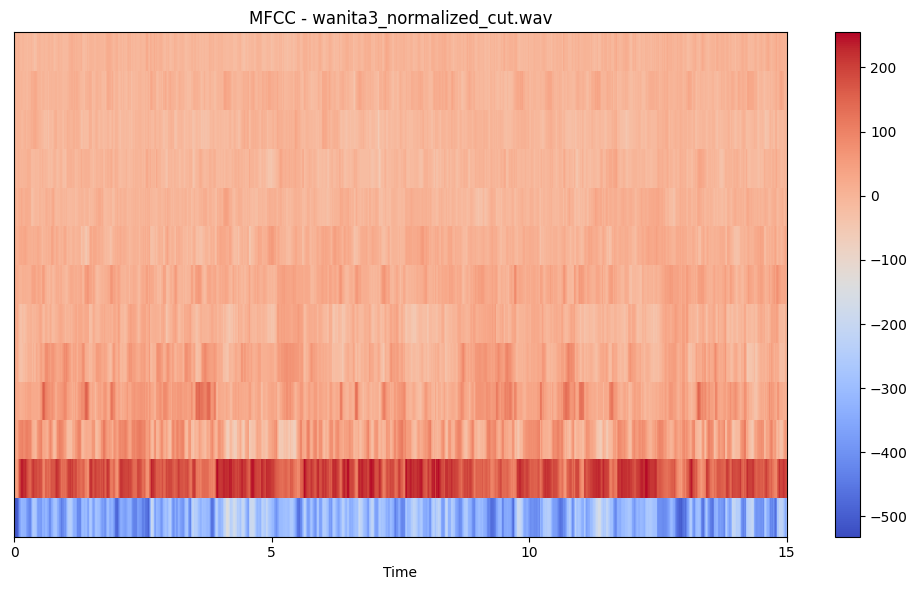

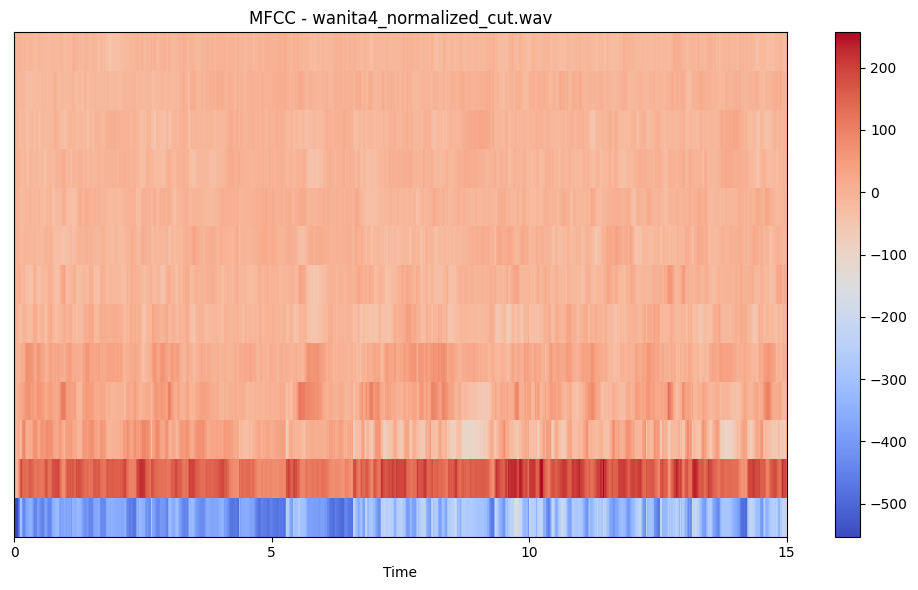

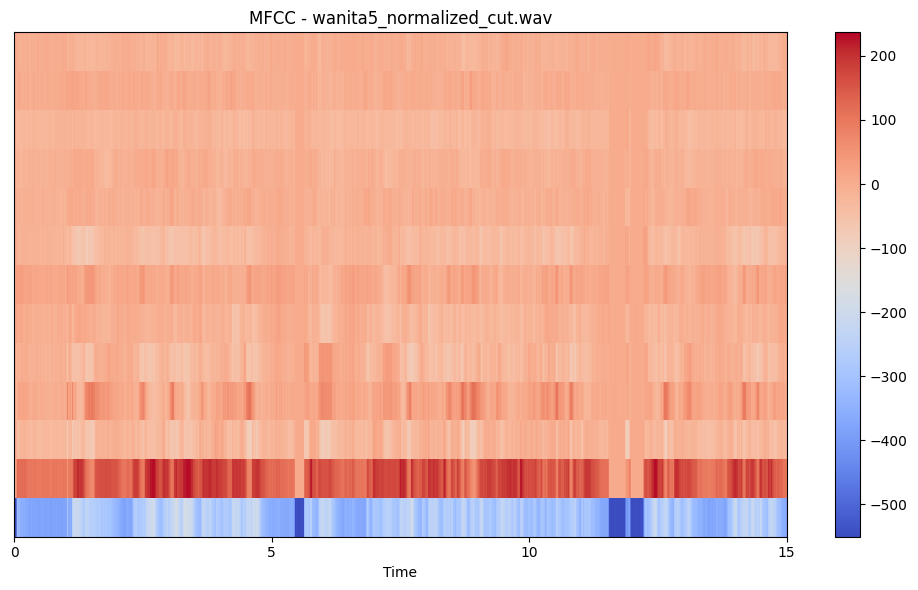

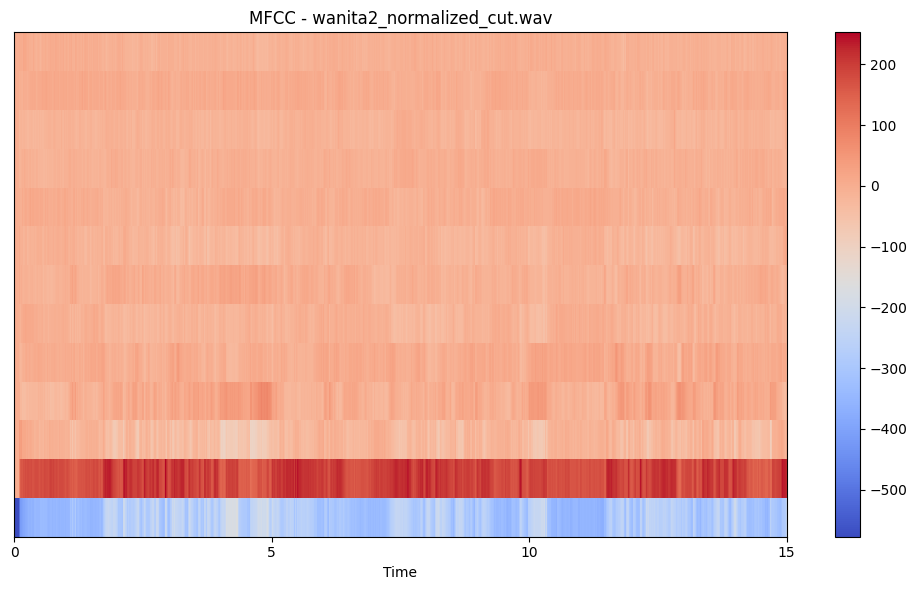

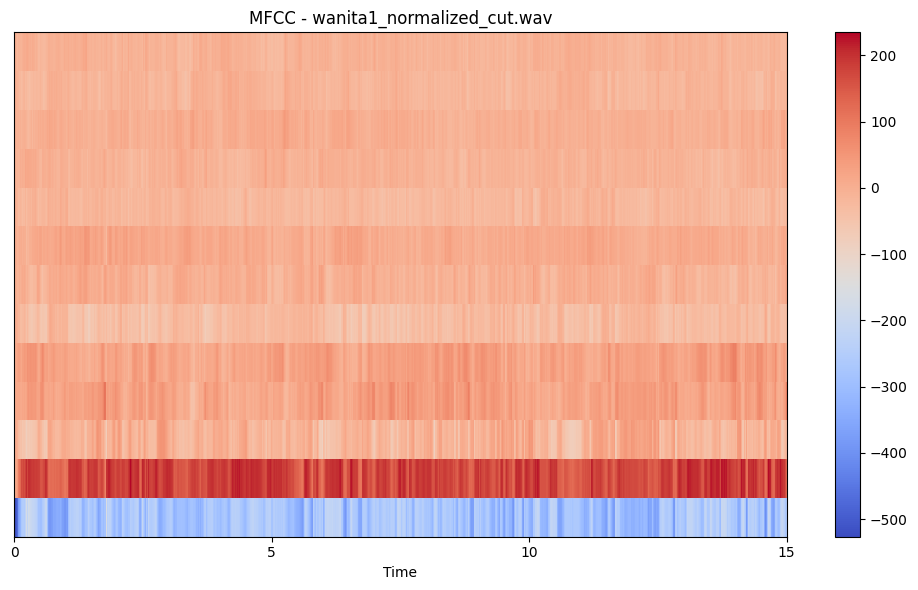

In [7]:
!pip install librosa matplotlib
import os
import librosa
import librosa.display
import matplotlib.pyplot as plt

# Path ke folder yang berisi file audio yang telah dipotong
cut_audio_dir = '/content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut'

# Menampilkan MFCC untuk setiap file audio
for filename in os.listdir(cut_audio_dir):
    if filename.endswith(".wav"):  # Filter file WAV
        file_path = os.path.join(cut_audio_dir, filename)

        # Memuat file audio
        y, sr = librosa.load(file_path, sr=None)  # sr=None untuk menggunakan sample rate asli

        # Ekstraksi fitur MFCC
        mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)  # 13 koefisien MFCC

        # Menampilkan plot MFCC
        plt.figure(figsize=(10, 6))
        librosa.display.specshow(mfcc, x_axis='time', sr=sr)
        plt.colorbar()
        plt.title(f'MFCC - {filename}')
        plt.tight_layout()

        # Menyimpan gambar MFCC (jika diperlukan)
        plt.savefig(f'/content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut/{filename}_mfcc.png')

        # Menampilkan gambar di notebook
        plt.show()


**3). PELATIHAN MODEL DAN PENDETEKSIAN SUARA**

**menyiapkan fitur MFCC dan label**

In [8]:
import os
import librosa
import numpy as np
from sklearn.model_selection import train_test_split

# Folder yang berisi file audio yang sudah dipotong dan dinormalisasi
audio_dir = '/content/drive/MyDrive/deteksisuara_PCD/hasilnorm/hasilcut'

# Inisialisasi daftar untuk menyimpan fitur dan label
X = []  # Fitur MFCC
y = []  # Label suara (pria, wanita, anak-anak)

# Daftar label yang sesuai
label_mapping = {'wanita': 1, 'pria': 0, 'anak': 2}  # Mapping label ke angka

# Loop melalui semua file audio di folder
for filename in os.listdir(audio_dir):
    if filename.endswith(".wav"):  # Filter file WAV
        file_path = os.path.join(audio_dir, filename)

        # Memuat file audio dan ekstraksi fitur MFCC
        y_audio, sr = librosa.load(file_path, sr=None)  # sr=None untuk menggunakan sample rate asli
        mfcc = librosa.feature.mfcc(y=y_audio, sr=sr, n_mfcc=15)  # Ekstraksi 13 koefisien MFCC

        # Menambahkan fitur MFCC ke dalam X (mengambil rata-rata MFCC untuk setiap frame)
        X.append(np.mean(mfcc, axis=1))  # Rata-rata MFCC untuk setiap file audio

        # Menambahkan label berdasarkan nama file (misalnya 'wanita5_normalized_cut.wav')
        if 'wanita' in filename:
            y.append(label_mapping['wanita'])
        elif 'pria' in filename:
            y.append(label_mapping['pria'])
        elif 'anak' in filename: # Changed 'anak-anak' to 'anak' to match file naming
            y.append(label_mapping['anak'])
        else:
            # Handle kasus jika nama file tidak sesuai dengan label yang diharapkan
            print(f"Skipping file {filename} due to unexpected name format.")
            # Menghapus fitur yang sesuai dari X jika label tidak ditemukan
            X.pop() # Remove the last appended feature if label is not found


# Mengonversi X dan y menjadi array numpy untuk pelatihan
X = np.array(X)
y = np.array(y)

# Memastikan X dan y memiliki jumlah sampel yang sama sebelum train_test_split
if len(X) != len(y):
    raise ValueError(f"Number of samples in X ({len(X)}) and y ({len(y)}) do not match.")

# Membagi data menjadi data pelatihan (80%) dan data pengujian (20%)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"Data pelatihan: {X_train.shape}, Data pengujian: {X_test.shape}")

Data pelatihan: (12, 15), Data pengujian: (3, 15)


**Melatih Model dengan SVM (Support Vector Machine)**

In [9]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report

# Membuat model SVM
model = SVC(kernel='linear')

# Melatih model dengan data pelatihan
model.fit(X_train, y_train)

# Menggunakan model untuk prediksi pada data pengujian
y_pred = model.predict(X_test)

# Evaluasi model
accuracy = accuracy_score(y_test, y_pred)
print(f"Akurasi: {accuracy}")
print("Laporan Klasifikasi:")
print(classification_report(y_test, y_pred))


Akurasi: 0.3333333333333333
Laporan Klasifikasi:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       0.00      0.00      0.00         1
           2       0.50      1.00      0.67         1

    accuracy                           0.33         3
   macro avg       0.17      0.33      0.22         3
weighted avg       0.17      0.33      0.22         3



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


**4. IMPLEMENTASI UI**

In [10]:
!pip install ipywidgets librosa

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 16.1 MB/s eta 0:00:00


In [11]:
import os
import librosa
import numpy as np
from sklearn.svm import SVC
from ipywidgets import FileUpload, Button, Output, VBox, HBox
from IPython.display import display, Audio

# Load model SVM yang telah dilatih sebelumnya
model = SVC(kernel='linear')  # Gantilah dengan model yang sudah dilatih
model.fit(X_train, y_train)   # Pastikan model ini dilatih sebelumnya

# Fungsi untuk ekstraksi fitur MFCC dari file audio
def extract_mfcc(file_path, n_mfcc=15):
    y, sr = librosa.load(file_path, sr=None)  # Load file audio
    mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc)
    return np.mean(mfcc, axis=1)  # Ambil rata-rata MFCC

# Fungsi untuk menangani upload file
uploaded_file_path = None  # Variabel global untuk menyimpan path file sementara
def handle_upload(change):
    global uploaded_file_path
    uploaded_file = upload_widget.value
    if uploaded_file:
        for name, file_info in uploaded_file.items():
            # Menyimpan file audio sementara
            uploaded_file_path = f'./{name}'
            with open(uploaded_file_path, 'wb') as f:
                f.write(file_info['content'])

            # Menampilkan informasi file berhasil diunggah
            output_widget.clear_output()
            with output_widget:
                print(f"File '{name}' berhasil diunggah.")
                display(Audio(uploaded_file_path))  # Menampilkan player audio

# Fungsi untuk deteksi suara ketika tombol ditekan
def detect_audio(b):
    global uploaded_file_path
    if uploaded_file_path is None:
        with output_widget:
            print("Silakan upload file terlebih dahulu sebelum mendeteksi.")
        return

    # Ekstraksi fitur MFCC dari file audio
    features = extract_mfcc(uploaded_file_path).reshape(1, -1)

    # Prediksi label menggunakan model
    prediction = model.predict(features)
    label_mapping = {0: 'Pria', 1: 'Wanita', 2: 'Anak-anak'}
    result = label_mapping[prediction[0]]

    # Menampilkan hasil prediksi
    output_widget.clear_output()
    with output_widget:
        print(f"Hasil Deteksi: {result}")
        display(Audio(uploaded_file_path))  # Menampilkan kembali player audio

# Widget untuk upload file audio
upload_widget = FileUpload(accept='.wav', multiple=False)
upload_widget.observe(handle_upload, names='_counter')

# Tombol untuk deteksi suara
detect_button = Button(description="Deteksi", button_style='success')
detect_button.on_click(detect_audio)

# Output widget untuk menampilkan hasil
output_widget = Output()

# Antarmuka pengguna
instruction = Output()
with instruction:
    print("1. Unggah file audio berformat WAV.\n2. Tekan tombol 'Deteksi' untuk mengetahui kategori suara.")

# Menampilkan UI
ui = VBox([
    instruction,
    HBox([upload_widget, detect_button]),
    output_widget
])
display(ui)
